In [2]:
import pandas as pd
from pandas.plotting import scatter_matrix
import matplotlib.pyplot as plt
from sklearn import model_selection
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
from sklearn.metrics import accuracy_score
from sklearn.linear_model import LogisticRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis
from sklearn.naive_bayes import GaussianNB
from sklearn.svm import SVC
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
import numpy as np
import pandas as pd
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
%matplotlib inline
import seaborn as sns
import pandas as pd
from sklearn.naive_bayes import GaussianNB
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder

from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.ensemble import AdaBoostClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.ensemble import ExtraTreesClassifier


In [3]:
df=pd.read_csv("file:///C:/Users/mdasi/Downloads/Compressed/neo_v2.csv/neo_v2.csv")
df.head()

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,absolute_magnitude,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,5.483974e+07,Earth,False,16.73,False
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,6.143813e+07,Earth,False,20.00,True
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,4.979872e+07,Earth,False,17.83,False
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,2.543497e+07,Earth,False,22.20,False
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,4.627557e+07,Earth,False,20.09,True


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 90836 entries, 0 to 90835
Data columns (total 10 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   id                  90836 non-null  int64  
 1   name                90836 non-null  object 
 2   est_diameter_min    90836 non-null  float64
 3   est_diameter_max    90836 non-null  float64
 4   relative_velocity   90836 non-null  float64
 5   miss_distance       90836 non-null  float64
 6   orbiting_body       90836 non-null  object 
 7   sentry_object       90836 non-null  bool   
 8   absolute_magnitude  90836 non-null  float64
 9   hazardous           90836 non-null  bool   
dtypes: bool(2), float64(5), int64(1), object(2)
memory usage: 5.7+ MB


In [5]:
df.dtypes

id                      int64
name                   object
est_diameter_min      float64
est_diameter_max      float64
relative_velocity     float64
miss_distance         float64
orbiting_body          object
sentry_object            bool
absolute_magnitude    float64
hazardous                bool
dtype: object

In [6]:
df.shape

(90836, 10)

In [7]:
df.columns

Index(['id', 'name', 'est_diameter_min', 'est_diameter_max',
       'relative_velocity', 'miss_distance', 'orbiting_body', 'sentry_object',
       'absolute_magnitude', 'hazardous'],
      dtype='object')

In [8]:
df.corr()

,id,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,sentry_object,absolute_magnitude,hazardous
id,1.000000,-0.148322,-0.148322,-0.059176,-0.056510,NaN,0.277258,-0.123443
est_diameter_min,-0.148322,1.000000,1.000000,0.221553,0.142241,NaN,-0.560188,0.183363
est_diameter_max,-0.148322,1.000000,1.000000,0.221553,0.142241,NaN,-0.560188,0.183363
relative_velocity,-0.059176,0.221553,0.221553,1.000000,0.327169,NaN,-0.353863,0.191185
miss_distance,-0.056510,0.142241,0.142241,0.327169,1.000000,NaN,-0.264168,0.042302
sentry_object,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
absolute_magnitude,0.277258,-0.560188,-0.560188,-0.353863,-0.264168,NaN,1.000000,-0.365267
hazardous,-0.123443,0.183363,0.183363,0.191185,0.042302,NaN,-0.365267,1.000000


In [9]:
df.describe()

,id,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,absolute_magnitude
count,9.083600e+04,90836.000000,90836.000000,90836.000000,9.083600e+04,90836.000000
mean,1.438288e+07,0.127432,0.284947,48066.918918,3.706655e+07,23.527103
std,2.087202e+07,0.298511,0.667491,25293.296961,2.235204e+07,2.894086
min,2.000433e+06,0.000609,0.001362,203.346433,6.745533e+03,9.230000
25%,3.448110e+06,0.019256,0.043057,28619.020645,1.721082e+07,21.340000
50%,3.748362e+06,0.048368,0.108153,44190.117890,3.784658e+07,23.700000
75%,3.884023e+06,0.143402,0.320656,62923.604633,5.654900e+07,25.700000
max,5.427591e+07,37.892650,84.730541,236990.128088,7.479865e+07,33.200000


In [10]:
df.corr().describe().T

,count,mean,std,min,25%,50%,75%,max
id,7.0,0.105926,0.421161,-0.148322,-0.135883,-0.059176,0.110374,1.0
est_diameter_min,7.0,0.262664,0.570936,-0.560188,-0.003041,0.183363,0.610777,1.0
est_diameter_max,7.0,0.262664,0.570936,-0.560188,-0.003041,0.183363,0.610777,1.0
relative_velocity,7.0,0.221203,0.413918,-0.353863,0.066005,0.221553,0.274361,1.0
miss_distance,7.0,0.190468,0.401731,-0.264168,-0.007104,0.142241,0.234705,1.0
sentry_object,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN
absolute_magnitude,7.0,-0.118059,0.567942,-0.560188,-0.462728,-0.353863,0.006545,1.0
hazardous,7.0,0.158786,0.423822,-0.365267,-0.040571,0.183363,0.187274,1.0


<AxesSubplot:>

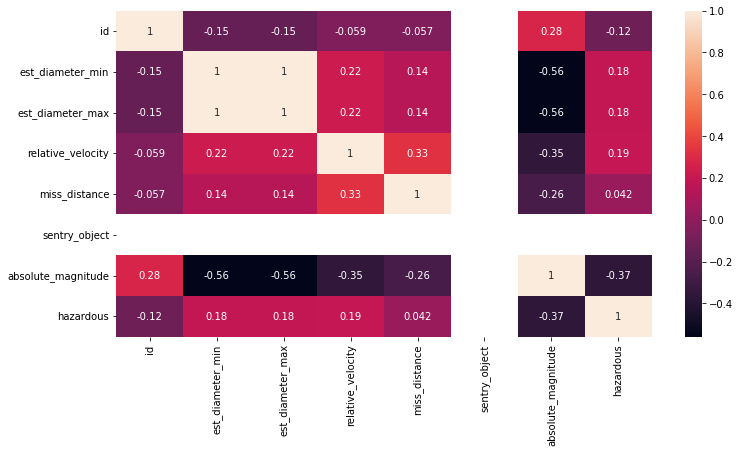

In [11]:
plt.figure(figsize=(12,6))
sns.heatmap(df.corr(),annot=True)

In [12]:
df=df.drop(['absolute_magnitude'],axis='columns')

In [13]:
df.shape

(90836, 9)

In [14]:
df.isnull().sum()

id                   0
name                 0
est_diameter_min     0
est_diameter_max     0
relative_velocity    0
miss_distance        0
orbiting_body        0
sentry_object        0
hazardous            0
dtype: int64

In [15]:
df.style

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,54839744.082846,Earth,0,0
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,61438126.523951,Earth,0,1
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,49798724.940457,Earth,0,0
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,25434972.720758,Earth,0,0
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,46275567.001301,Earth,0,1
5,54138696,(2021 GY23),0.036354,0.081291,34297.587778,40585691.227923,Earth,0,0
6,54189957,(2021 PY40),0.171615,0.383743,27529.472307,29069121.418649,Earth,0,0
7,54230078,(2021 XD6),0.005328,0.011914,57544.470083,55115019.258071,Earth,0,0
8,2088213,88213 (2001 AF2),0.350393,0.783502,56625.210122,69035980.038816,Earth,0,0
9,3766065,(2016 YM),0.105817,0.236614,48425.840329,38355261.560761,Earth,0,0


In [16]:
for i  in df.columns:
    print(f'unique values in column "{i}" is\n {df[i].value_counts()}')
    print('-------------------------------------------------')

unique values in column "id" is
 2469219    43
2277810    43
3743123    40
2138175    39
3893865    38
           ..
3768019     1
3774692     1
3779049     1
3775040     1
3092229     1
Name: id, Length: 27423, dtype: int64
-------------------------------------------------
unique values in column "name" is
 469219 Kamo`oalewa (2016 HO3)    43
277810 (2006 FV35)               43
(2016 CA138)                     40
138175 (2000 EE104)              39
(2019 XS)                        38
                                 ..
(2017 CS)                         1
(2017 KJ3)                        1
(2017 OA20)                       1
(2017 KK27)                       1
(1999 LV7)                        1
Name: name, Length: 27423, dtype: int64
-------------------------------------------------
unique values in column "est_diameter_min" is
 0.035039    1130
0.029144    1058
0.023150     995
0.031956     988
0.022108     977
            ... 
0.008912       1
1.623884       1
0.108882       1
0.05

In [17]:
object_col=[]
num_col=[]
for i in df.columns:
    if df[i].dtype=='object':
        object_col.append(i)
    else:
        num_col.append(i)

In [18]:
num_col

['id',
 'est_diameter_min',
 'est_diameter_max',
 'relative_velocity',
 'miss_distance',
 'sentry_object',
 'hazardous']

In [19]:
object_col

['name', 'orbiting_body']

In [20]:
df.max()

id                                   54275914
name                 99942 Apophis (2004 MN4)
est_diameter_min                     37.89265
est_diameter_max                    84.730541
relative_velocity               236990.128088
miss_distance                 74798651.452197
orbiting_body                           Earth
sentry_object                           False
hazardous                                True
dtype: object

In [21]:
df.min()

id                       2000433
name                   (1983 LC)
est_diameter_min        0.000609
est_diameter_max        0.001362
relative_velocity     203.346433
miss_distance        6745.532516
orbiting_body              Earth
sentry_object              False
hazardous                  False
dtype: object

In [22]:
df.skew()

C:\Users\mdasi\AppData\Local\Temp\ipykernel_12056\1665899112.py:1: FutureWarning: Dropping of nuisance columns in DataFrame reductions (with 'numeric_only=None') is deprecated; in a future version this will raise TypeError.  Select only valid columns before calling the reduction.
  df.skew()


id                    1.378459
est_diameter_min     41.139952
est_diameter_max     41.139952
relative_velocity     0.905125
miss_distance        -0.042706
sentry_object         0.000000
hazardous             2.717282
dtype: float64

<AxesSubplot:>

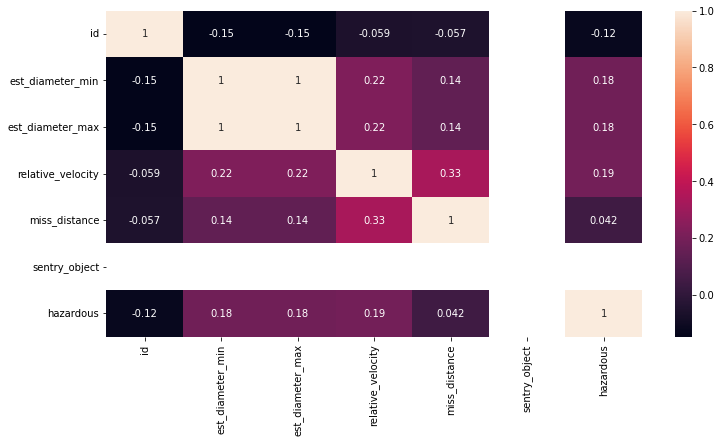

In [23]:
plt.figure(figsize=(12,6))
sns.heatmap(df.corr(),annot=True)

In [24]:
import dtale
dtale.show(df)

2022-07-02 09:55:11,170 - WARNING  - findfont: Font family ['Heiti TC'] not found. Falling back to DejaVu Sans.
C:\Users\mdasi\AppData\Local\Temp\ipykernel_12056\3368001520.py:4: UserWarning:

Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.



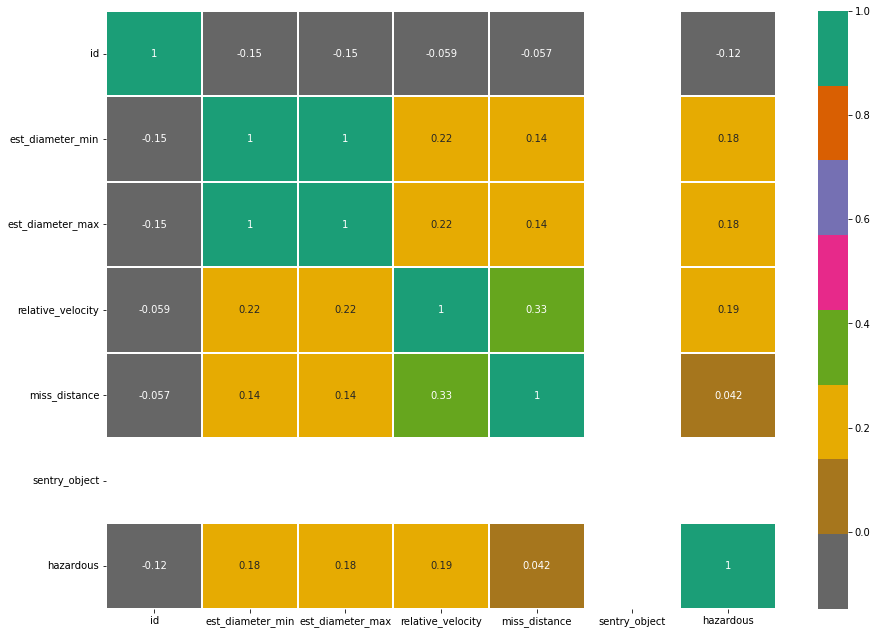

In [25]:
plt.figure(figsize=(15,11))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.heatmap(df.corr(),annot=True,cmap='Dark2_r',linewidths=2)
plt.show()

In [26]:
df.columns

Index(['id', 'name', 'est_diameter_min', 'est_diameter_max',
       'relative_velocity', 'miss_distance', 'orbiting_body', 'sentry_object',
       'hazardous'],
      dtype='object')

In [27]:
df.dtypes

id                     int64
name                  object
est_diameter_min     float64
est_diameter_max     float64
relative_velocity    float64
miss_distance        float64
orbiting_body         object
sentry_object           bool
hazardous               bool
dtype: object

In [28]:
df.head()

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,5.483974e+07,Earth,False,False
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,6.143813e+07,Earth,False,True
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,4.979872e+07,Earth,False,False
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,2.543497e+07,Earth,False,False
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,4.627557e+07,Earth,False,True


In [29]:
df['orbiting_body'].unique

<bound method Series.unique of 0        Earth
1        Earth
2        Earth
3        Earth
4        Earth
         ...  
90831    Earth
90832    Earth
90833    Earth
90834    Earth
90835    Earth
Name: orbiting_body, Length: 90836, dtype: object>

In [30]:
df.columns

Index(['id', 'name', 'est_diameter_min', 'est_diameter_max',
       'relative_velocity', 'miss_distance', 'orbiting_body', 'sentry_object',
       'hazardous'],
      dtype='object')

In [31]:
le=LabelEncoder()
df_col=('orbiting_body', 'sentry_object','hazardous')
for i in df_col:
    df[i]=le.fit_transform(df[i])

In [32]:
df.head()

,id,name,est_diameter_min,est_diameter_max,relative_velocity,miss_distance,orbiting_body,sentry_object,hazardous
0,2162635,162635 (2000 SS164),1.198271,2.679415,13569.249224,5.483974e+07,0,0,0
1,2277475,277475 (2005 WK4),0.265800,0.594347,73588.726663,6.143813e+07,0,0,1
2,2512244,512244 (2015 YE18),0.722030,1.614507,114258.692129,4.979872e+07,0,0,0
3,3596030,(2012 BV13),0.096506,0.215794,24764.303138,2.543497e+07,0,0,0
4,3667127,(2014 GE35),0.255009,0.570217,42737.733765,4.627557e+07,0,0,1


In [33]:
df.dtypes

id                     int64
name                  object
est_diameter_min     float64
est_diameter_max     float64
relative_velocity    float64
miss_distance        float64
orbiting_body          int32
sentry_object          int64
hazardous              int64
dtype: object

In [34]:
df['name'].unique

<bound method Series.unique of 0        162635 (2000 SS164)
1          277475 (2005 WK4)
2         512244 (2015 YE18)
3                (2012 BV13)
4                (2014 GE35)
                ...         
90831             (2016 VX1)
90832             (2019 AD3)
90833             (2020 JP3)
90834             (2021 CN5)
90835             (2021 TW7)
Name: name, Length: 90836, dtype: object>

In [35]:
df=df.drop(['id'],axis='columns')

In [36]:
df.columns

Index(['name', 'est_diameter_min', 'est_diameter_max', 'relative_velocity',
       'miss_distance', 'orbiting_body', 'sentry_object', 'hazardous'],
      dtype='object')

In [37]:
for i in ['est_diameter_min', 'est_diameter_max', 'relative_velocity',
       'miss_distance', 'orbiting_body', 'sentry_object', 'hazardous']:
    plt.figure(figsize=(15,9))
    sns.boxplot(y=df.name,x=df[i],data=df,linewidth=1,)
    plt.show()

C:\Users\mdasi\AppData\Local\Temp\ipykernel_12056\2827876366.py:5: UserWarning:

Matplotlib is currently using agg, which is a non-GUI backend, so cannot show the figure.

